# Compute and plot statistics on the performance of a Track fitting models

A Track fitting model aims to fit the positions of the trajectory points of a track, givent its hits. In this notebook we investigate the performances of such a model.

### Define parameters

In [1]:
primary_tracks_only = True # Do we use the dataset with primary tracks only or with all tracks?
predict_directions = False # Do we also predict directions or only positions?
use_sparse_cnn=True # Is the model a Sparse CNN MinkUNet or a Transformer?
finetuned=False # Was the model finetuned?
intermediate=False # Is the model an intermediate finetuning step?
run_test=False # do we run the test this time or do we simply load the preexisting results

### Define paths

In [2]:
model_root_path=f"../../models_weights/"
test_set_path="/scratch4/maubin/data/pgun_test"
scaler_file_path="../../sfgnets/datasets/scalers/scaler_trackfit.p"
prediction_root_path=f"/scratch4/maubin/results_best_models/"

### Define model parameters

In [3]:
# j=22 # id of the model (useful when testing many models)
j=f"{'p' if primary_tracks_only else 'a'}{'PD' if predict_directions else 'P'}" # best models are indexed by their data configuration ("pP","pPD","aP","aPD")
targets=[0,1] if  predict_directions else [0] # indexes of the targets to be used: 0 is the position, 1 the direction
inputs=[0] # indexes of the inputs to be used: 0 is the charge, 1 is the hit tag

model_path=f"{model_root_path}trackfit_model_{'sparse_cnn_' if use_sparse_cnn else ''}{j}{'_finetuned' if finetuned else ''}{'_intermediate' if intermediate else ''}.torch"
prediction_path=f'{prediction_root_path}track_fitting_model_{"sparse_cnn_" if use_sparse_cnn else ""}{j}{"_finetuned" if finetuned else ""}{"_intermediate" if intermediate else ""}_pred.pkl'

## Load the relevant objects

In [4]:
import os
import sys
import pickle as pk
import torch.nn as nn
import tqdm
import numpy as np
import torch
import importlib
import matplotlib.pyplot as plt

os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = "1"
os.environ["CUDA_LAUNCH_BLOCKING"] = "1"


torch.multiprocessing.set_sharing_strategy('file_system')

from sfgnets import track_fitting_net
importlib.reload(track_fitting_net)

from sfgnets.utils import plot_3D_events
importlib.reload(plot_3D_events)

from sfgnets.track_fitting_net import plot
importlib.reload(plot)

from sfgnets.utils import track_recon as tr
importlib.reload(tr);

In [5]:
x_in_channels=len(inputs) if inputs is not None else 2

dataset=track_fitting_net.PGunEvent(root=test_set_path,
                                scaler_file=scaler_file_path,
                                shuffle=True,
                                targets=targets,
                                inputs=inputs,
                                use_true_tag=True,
                                scale_coordinates=(not use_sparse_cnn),
                                masking_scheme='primary' if primary_tracks_only else 'distance',
                                )

model = track_fitting_net.create_sparse_cnn_model(y_out_channels=sum(dataset.targets_lengths)+sum(dataset.targets_n_classes),x_in_channels=x_in_channels) if use_sparse_cnn else track_fitting_net.create_transformer_model(y_out_channels=sum(dataset.targets_lengths)+sum(dataset.targets_n_classes),x_in_channels=x_in_channels)
# load model state dict
model.load_state_dict(torch.load(model_path))
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)
collate_fn=track_fitting_net.collate_minkowski if use_sparse_cnn else track_fitting_net.collate_transformer

In [6]:
full_loader=track_fitting_net.full_dataset(dataset,
                                           collate=collate_fn,
                                        #    batch_size=256 if use_sparse_cnn else 16,
                                           batch_size=1,
                                           )

In [7]:
if run_test:
    all_results=track_fitting_net.test_full(loader=full_loader,
                                            model=model,
                                            model_type="minkowski" if use_sparse_cnn else "transformer",
                                            progress_bar=True,
                                            device=device,
                                            do_we_consider_aux=True,
                                            do_we_consider_coord=True,
                                            do_we_consider_feat=True,
                                            # max_batches=10,
                                            )

    perf_fn=track_fitting_net.perf_fn
    if targets is not None:
            perf_fn=perf_fn[targets]
            perf_fn.rebuild_partial_losses()

    all_results=track_fitting_net.measure_performances(all_results,
                                                        dataset,
                                                        perf_fn,
                                                        device, 
                                                        model_type="minkowski" if use_sparse_cnn else "transformer",
                                                        do_we_consider_aux=True,
                                                        do_we_consider_coord=True,
                                                        do_we_consider_feat=True,)

    with open(prediction_path, 'wb') as file:
        pk.dump(all_results,file)

In [8]:
with open(prediction_path, 'rb') as file:
    all_results=pk.load(file)

In [9]:
datacontainer=plot.DataContainer(all_results,dataset)

In [10]:
plot.intersect_list_indexes([
                            plot.list_index_number_hits(datacontainer,min_number_hits=400, max_number_hits=None, imax=100),
                            # plot.list_index_NTraj(datacontainer,4,imax=1000),
                            # plot.list_index_input_particle(datacontainer,'mu-',imax=100),
                            ])

[40, 83, 96]

In [11]:
i=83
importlib.reload(plot)
plot.plot_event_display(datacontainer,i,
                        show_target_momentum=False,
                        # show_pred_momentum=True,
                        compare_to_bayesian_filter=True,
                        cone_scale=0.5,
                        figsize=(1000, 600),
                        cmap="cool",
                        hit_opacity_factor=0.2);

Input particle: mu-  1998 MeV


Plotting bare_distance...  
	Model
Mean: 1.213 mm
68%:  0.974 mm
95%:  3.154 mm
Mode: 0.450 mm
	Bayesian Filter
Mean: 3.062 mm
68%:  2.049 mm
95%:  5.945 mm
Mode: 0.950 mm


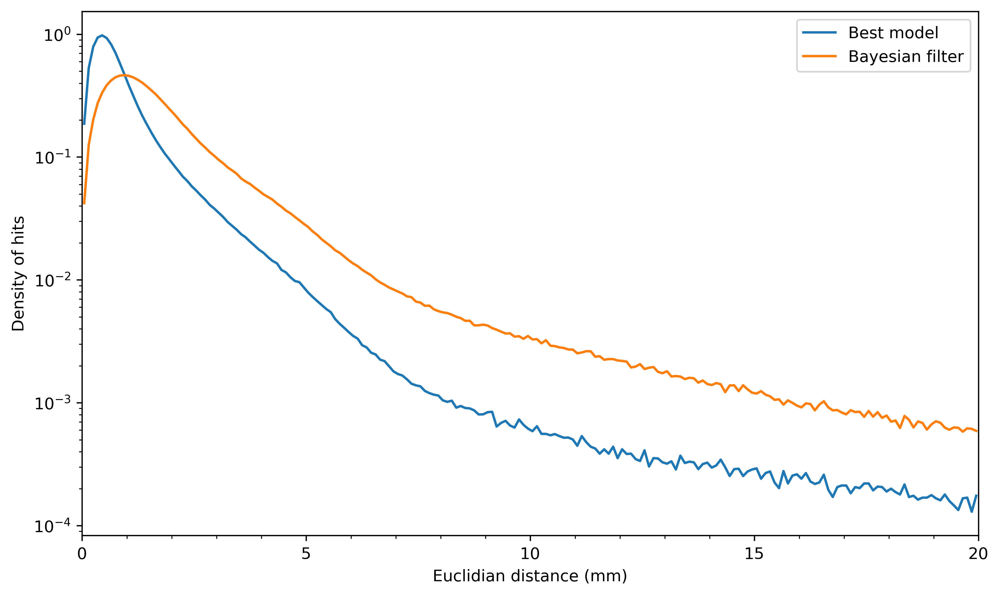

In [12]:
importlib.reload(plot)
plot.plots(datacontainer,
          #  plots_chosen=["euclidian_distance","perf_kin_ener"],
           plots_chosen=["bare_distance"],
           model_name=str(j),
        #    mode="mom_d",
            compare_to_bayesian_filter=True,
            dpi=400,
            figsize=(10,6),
            Nbins=200,
            );

Plotting pred_X...  
Plotting euclidian_distance...  
Plotting euclidian_distance_by_pdg...  


Plotting perf_charge...  


Computing performances: 100%|██████████| 99/99 [00:00<00:00, 209.03it/s]


Plotting perf_distance...  


Computing performances: 100%|██████████| 99/99 [00:00<00:00, 215.02it/s]


Plotting euclidian_distance_by_primary...  


[<Figure size 1152x576 with 1 Axes>,
 <Figure size 1728x576 with 2 Axes>,
 <Figure size 1728x6336 with 22 Axes>,
 <Figure size 4800x3600 with 2 Axes>,
 <Figure size 4800x3600 with 2 Axes>,
 <Figure size 1728x1152 with 4 Axes>]

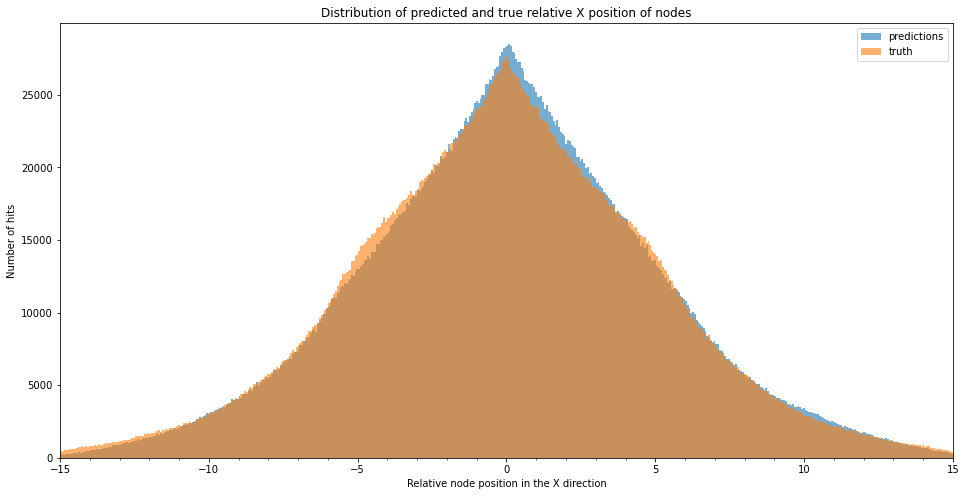

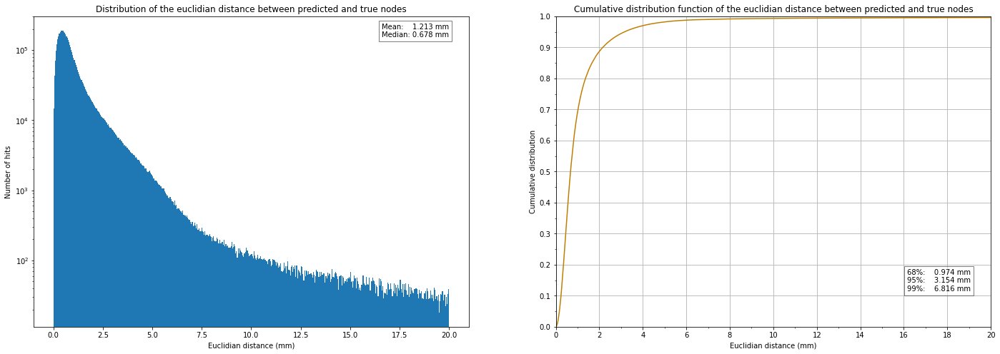

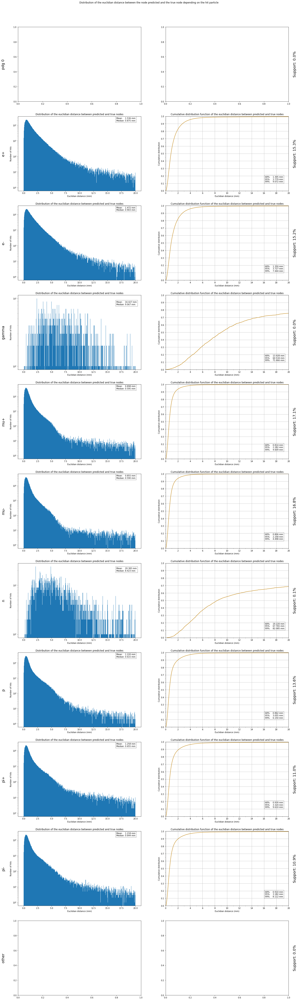

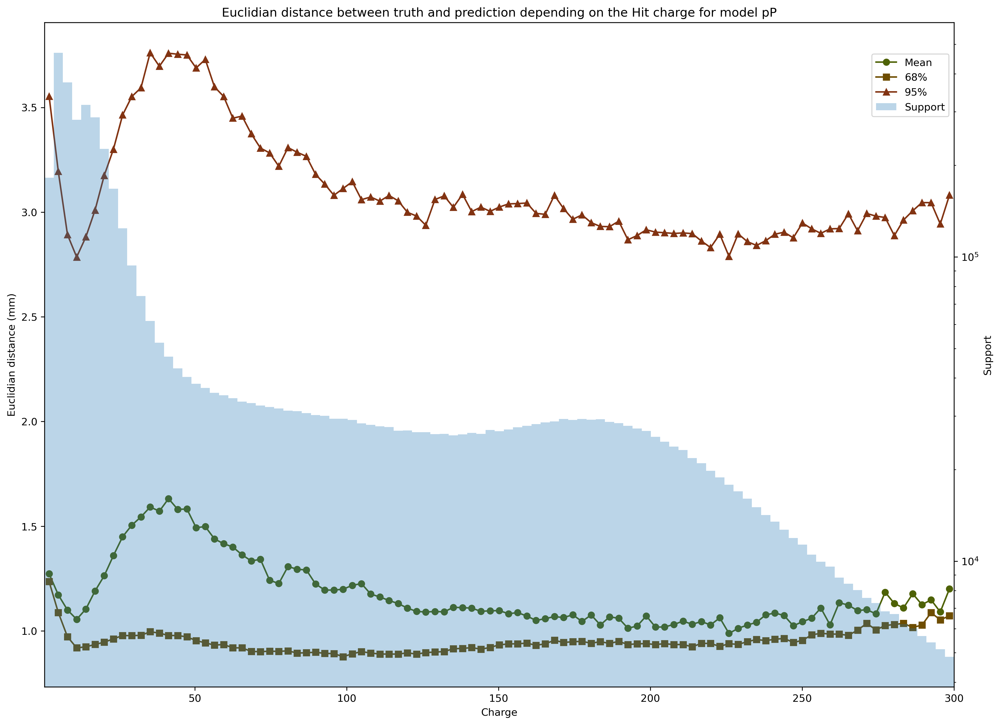

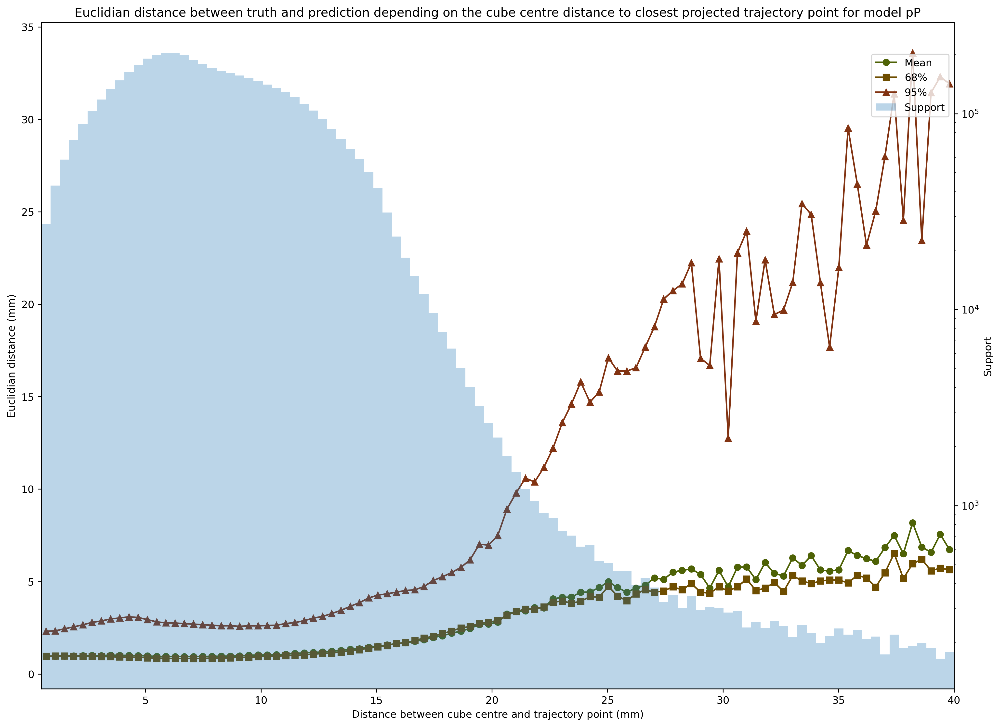

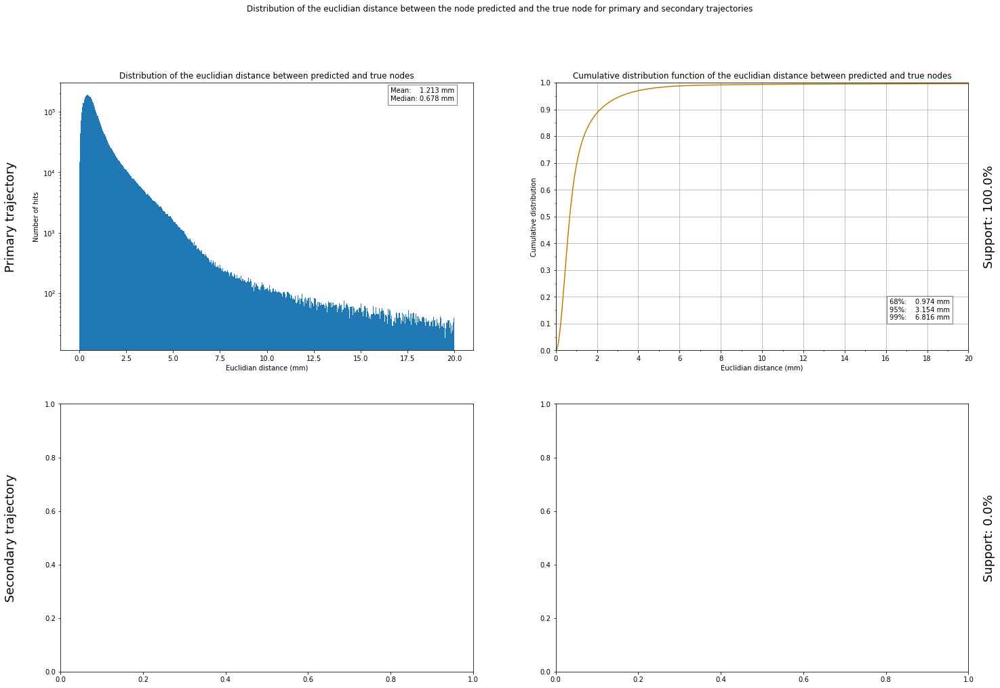

In [13]:
# plot.plots(datacontainer2,
#             # plots_chosen=["euclidian_distance"],
#             plots_chosen=["pred_X","euclidian_distance","euclidian_distance_by_pdg","perf_charge","perf_distance", "euclidian_distance_by_primary","perf_traj_length"],
#             # plots_chosen=["perf_traj_length"],
#             # model_name=str(j),
#             model_name="bayesian filter sparse_cnn primary mask",
#             savefig_path='/scratch4/maubin/plots/track_fitting_model_bayesian_filter_sparse_cnn.png',
#             );
plot.plots(datacontainer,
            # plots_chosen=["euclidian_distance"],
            plots_chosen=["pred_X","euclidian_distance","euclidian_distance_by_pdg","perf_charge","perf_distance", "euclidian_distance_by_primary",],
            model_name=str(j),
            # mode='mom'
            )
# plot.plots(datacontainer2,
#             # plots_chosen=["euclidian_distance"],
#             plots_chosen=["pred_X","euclidian_distance","euclidian_distance_by_pdg","perf_charge","perf_distance", "euclidian_distance_by_primary","perf_traj_length"],
#             # plots_chosen=["perf_traj_length"],
#             model_name="bayesian filter sparse_cnn primary mask",
#             mode='mom_d',
#             savefig_path='/scratch4/maubin/plots/track_fitting_model_bayesian_filter_sparse_cnn.png',
#             );
# # plot.plots(datacontainer,
# #             plots_chosen=["euclidian_distance"],
# #             # plots_chosen=["pred_X","euclidian_distance","euclidian_distance_by_pdg","perf_charge","perf_distance", "euclidian_distance_by_primary",],
# #             model_name=str(j),
# #             mode='mom_n'
# #             );

In [14]:
event_ids, indexes, counts = np.unique(datacontainer.event_id,return_index=True,return_counts=True)

In [15]:
import pandas as pd

In [16]:
dat=pd.DataFrame({
              'nb_hits':counts,
              'input_particle_pdg':datacontainer.input_particle[indexes],
              })

Electrons : 121.63552394964852 hits   14.16039810207152 %
Muons : 135.28932676518883 hits   14.088647147320913 %
Pions : 88.13747319808675 hits   14.033098021062376 %
Protons : 109.003796632552 hits   14.021525286425183 %
Neutrons : 7.678132678132678 hits   0.9420205994676542 %
Gammas : 8.54 hits   0.4629093854877908 %


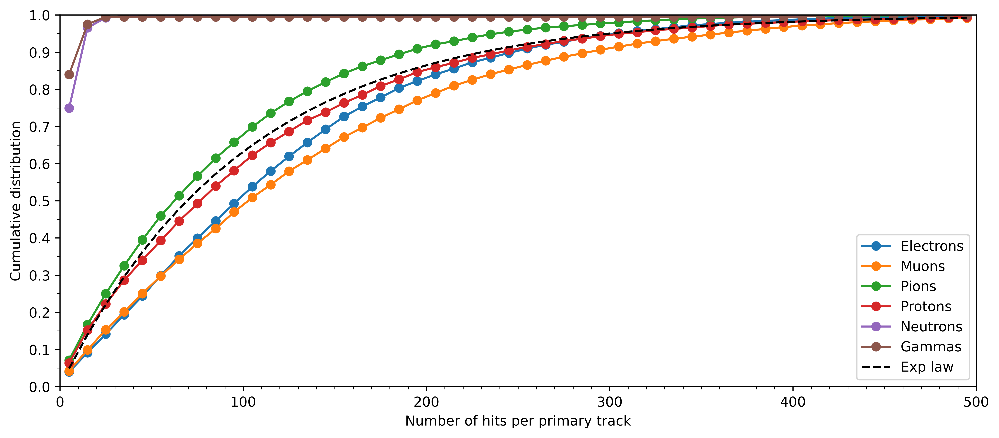

In [17]:
fig,ax=plt.subplots(figsize=(12,5),dpi=600,facecolor='white')
ranges=(0,500)

X,Y=[],[]

particles=['Electrons','Muons','Pions','Protons','Neutrons','Gammas']
PDGs=[11,13,211,2212,2112,22]


# particles=['Electrons-','Electrons+','Muons-','Muons+','Pions+','Pions-','Protons','Neutrons','Gammas']
# PDGs=[11,-11,13,-13,211,-211,2212,2112,22]

# bins=list(np.linspace(0,100,8,endpoint=False))+list(np.linspace(100,300,10,endpoint=False))+list(np.linspace(300,500,6))
bins=50

for pdg,part in zip(PDGs,particles):
    hist,bin_edges=np.histogram(dat[np.abs(dat['input_particle_pdg'])==pdg]['nb_hits'],range=ranges,bins=bins,density=False,)
    x=(bin_edges[1:]+bin_edges[:-1])/2.
    ax.plot(x,hist.cumsum()/(np.abs(dat['input_particle_pdg'])==pdg).sum(),label=part,marker='o')
    if pdg==13:
        X.extend(x)
        Y.extend(hist)
    print(part,':',dat[np.abs(dat['input_particle_pdg'])==pdg]['nb_hits'].mean(), 'hits  ',((dat['input_particle_pdg'])==pdg).mean()*100,'%')

ax.plot(x,1-np.exp(-0.01*x),label='Exp law',color="black",ls='--')

ax.set_xlim(ranges)
ax.set_xlabel('Number of hits per primary track')
ax.set_ylabel('Cumulative distribution')
ax.legend()
# ax.set_ylim((0.,1e-2))
ax.set_ylim((0.,1.))
ax.set_yticks(np.linspace(0,1.,11),major=True)
ax.set_yticks(np.linspace(0,1.,21),minor=True)
ax.set_xticks(np.linspace(ranges[0],ranges[1],51),minor=True)
# ax.set_yscale('log')
fig.show();

In [18]:
from sklearn.linear_model import LinearRegression

reg = LinearRegression().fit(np.array(X).reshape(-1,1),np.log(np.array(Y)+1).reshape(-1,1))

In [19]:
reg.score(np.array(X).reshape(-1,1),np.log(np.array(Y)+1).reshape(-1,1))

0.9728652743253382

In [20]:
reg.coef_

array([[-0.008]])

In [21]:
reg.intercept_

array([6.882])

In [23]:
import torchinfo

if not use_sparse_cnn:
    for dat in full_loader:
        features=dat['f'].to(device)
        # create masks
        src_mask, src_padding_mask = track_fitting_net.create_mask_src(features)
        # # run model
        # batch_output = model(features, src_mask, src_padding_mask)
        print(torchinfo.summary(model,input_data=[features, src_mask, src_padding_mask],
                                col_names=["output_size", "num_params","params_percent", "input_size"],depth=1))
        break